In [147]:
from paths import DATA_DIR, CKPT_FOLDER, PROJECT_FOLDER

import matplotlib.pyplot as plt
import numpy as np
import torch
import scanpy as sc
import scvelo as scv

import anndata
import pandas as pd

from torchdyn.core import NeuralODE

from scCFM.models.base.geodesic_ae import GeodesicAE
from scCFM.datamodules.time_sc_datamodule import TrajectoryDataModule
from scCFM.models.cfm.components.mlp import MLP
from scCFM.models.cfm.cfm_module import CFMLitModule
from scCFM.models.base.vae import VAE
from scCFM.models.base.geometric_vae import GeometricNBVAE
from scCFM.datamodules.sc_datamodule import scDataModule
from scCFM.models.cfm.components.eval.distribution_distances import compute_distribution_distances

from notebooks.utils import (standardize_adata,
                             add_keys_to_dict,
                             real_reconstructed_cells_adata,
                             add_velocity_to_adata, 
                             compute_velocity_projection, 
                             compute_trajectory, 
                             decode_trajectory)

In [148]:
sc.set_figure_params(scanpy=True,
                         dpi=90, 
                         dpi_save=150,
                         frameon=False, 
                         vector_friendly=True,
                         fontsize=14, 
                         figsize=None,
                         color_map=None, 
                         format='pdf', 
                         facecolor=None, 
                         transparent=False, 
                         ipython_format='png2x')


scv.set_figure_params('scvelo', transparent=True, fontsize=20)

In [149]:
device = "cuda" if torch.cuda.is_available() else "cpu"

**Read the anndata files**

First, read the latent space anndata and plot the results

In [150]:
adata_latent_vae = sc.read_h5ad(DATA_DIR / "eb" / "flat" / "eb_lib.h5ad")
adata_latent_flat = sc.read_h5ad(DATA_DIR / "eb" / "flat" / "eb_flat_lib.h5ad")
adata_latent_geodesic = sc.read_h5ad(DATA_DIR / "eb" / "flat" / "eb_geodesic.h5ad")

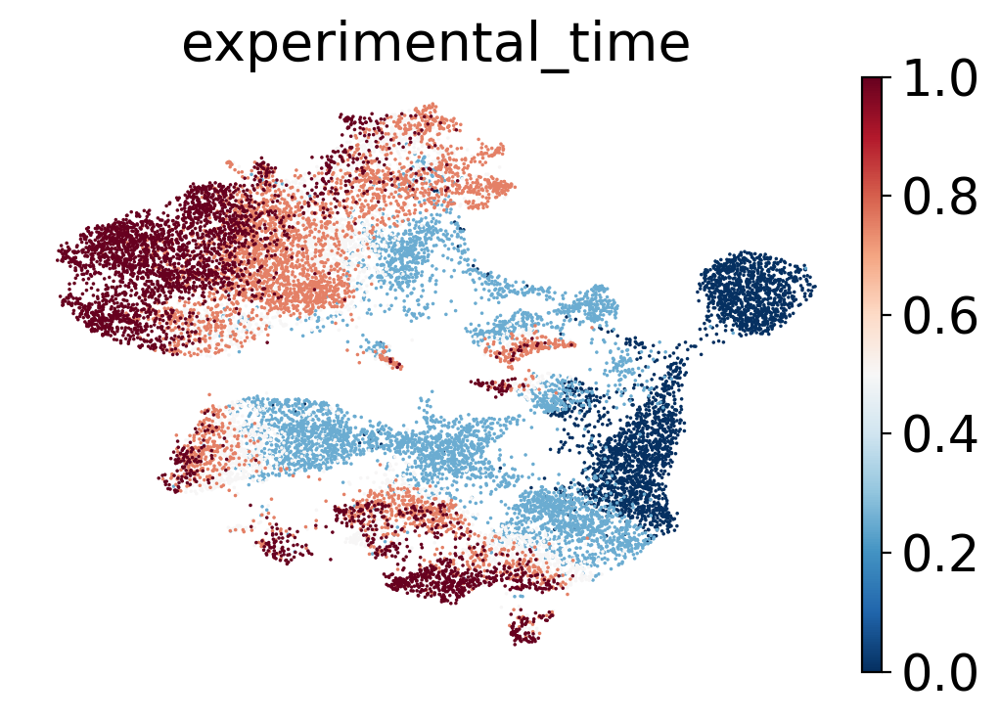

In [151]:
sc.pl.umap(adata_latent_vae, color="experimental_time")

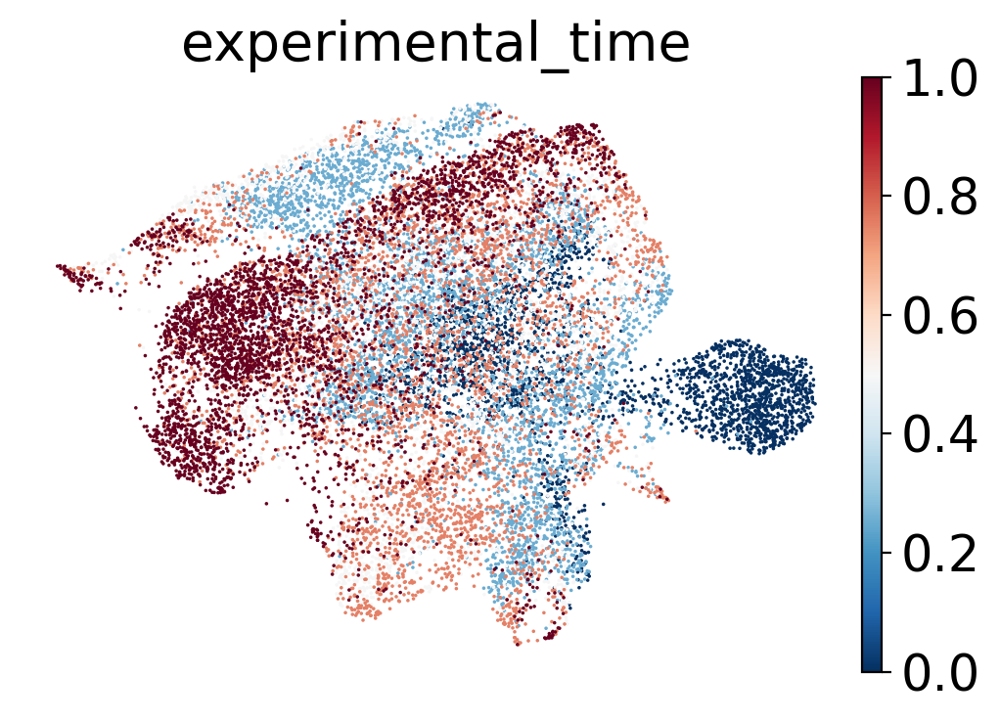

In [152]:
sc.pl.umap(adata_latent_flat, color="experimental_time")

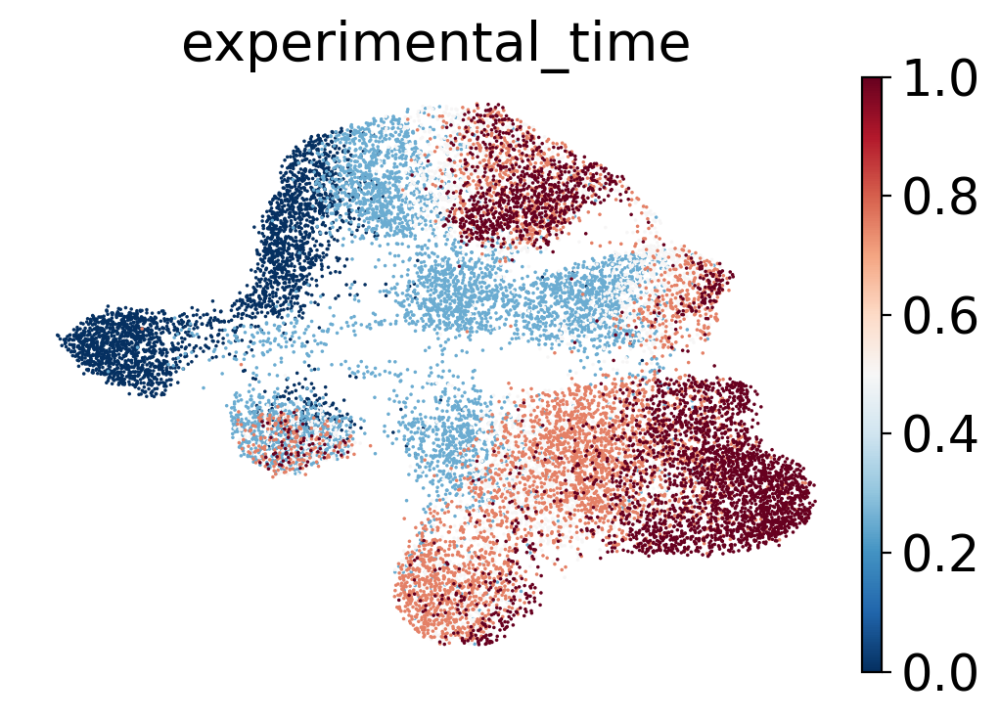

In [153]:
sc.pl.umap(adata_latent_geodesic, color="experimental_time")

Initialize datamodule

In [154]:
datamodule_kwargs_vae = {'path': DATA_DIR / "eb" / "flat" / "eb_lib.h5ad",
                          'x_layer': 'X_latents',
                          'time_key': 'experimental_time', 
                          'use_pca': False, 
                          'n_dimensions': None, 
                          'train_val_test_split': [0.9, 0.1], 
                          'num_workers': 2, 
                          'batch_size': 512, 
                          'model_library_size': True}

datamodule_kwargs_flat = {'path': DATA_DIR / "eb" / "flat" / "eb_flat_lib.h5ad",
                          'x_layer': 'X_latents',
                          'time_key': 'experimental_time', 
                          'use_pca': False, 
                          'n_dimensions': None, 
                          'train_val_test_split': [0.9, 0.1], 
                          'num_workers': 2, 
                          'batch_size': 512, 
                           'model_library_size': True}

datamodule_kwargs_geodesic= {'path': DATA_DIR / "eb" / "flat" / "eb_geodesic.h5ad",
                              'x_layer': 'X_latents',
                              'time_key': 'experimental_time', 
                              'use_pca': False, 
                              'n_dimensions': None, 
                              'train_val_test_split': [0.9, 0.1], 
                              'num_workers': 2, 
                              'batch_size': 512, 
                              'model_library_size': True}


# Initialize the datamodules 
datamodule_vae = TrajectoryDataModule(**datamodule_kwargs_vae)
datamodule_flat = TrajectoryDataModule(**datamodule_kwargs_flat)
datamodule_geodesic = TrajectoryDataModule(**datamodule_kwargs_geodesic)

# Mapping real times to index
idx2time = datamodule_vae.idx2time

Velocity field network

In [155]:
net_hparams = {"dim": datamodule_vae.dim,
                "w": 64,
                "time_varying": True}

net_vae = MLP(**net_hparams).to(device)
net_flat = MLP(**net_hparams).to(device)
net_geodesic = MLP(**net_hparams).to(device)

CFM model 

In [156]:
cfm_kwargs = {'ot_sampler': 'exact', 
                   'sigma': 0.1, 
                   'use_real_time': False, 
                   'lr': 0.001, 
                   'antithetic_time_sampling': True}

cfm_vae = CFMLitModule(net=net_vae, datamodule=datamodule_vae, **cfm_kwargs).to(device)
cfm_flat = CFMLitModule(net=net_flat, datamodule=datamodule_flat, **cfm_kwargs).to(device)
cfm_geodesic = CFMLitModule(net=net_geodesic, datamodule=datamodule_geodesic, **cfm_kwargs).to(device)

In [157]:
cfm_vae.load_state_dict(torch.load(CKPT_FOLDER / "trajectory" / "eb" / "best_cfm_model_eb.ckpt")["state_dict"])
cfm_flat.load_state_dict(torch.load(CKPT_FOLDER / "trajectory" / "eb" / "best_cfm_model_flat_eb.ckpt")["state_dict"])
cfm_geodesic.load_state_dict(torch.load(CKPT_FOLDER / "trajectory" / "eb_old" / "best_cfm_model_geodesic_eb.ckpt")["state_dict"])

<All keys matched successfully>

**Add velocities to anndata and plot them onto the umap and pca**

In [158]:
add_velocity_to_adata(adata_latent_vae, cfm_vae, device)
add_velocity_to_adata(adata_latent_flat, cfm_flat, device)
add_velocity_to_adata(adata_latent_geodesic, cfm_geodesic, device)

Non geometric

  0%|          | 0/18176 [00:00<?, ?cell/s]

  0%|          | 0/18176 [00:00<?, ?cell/s]

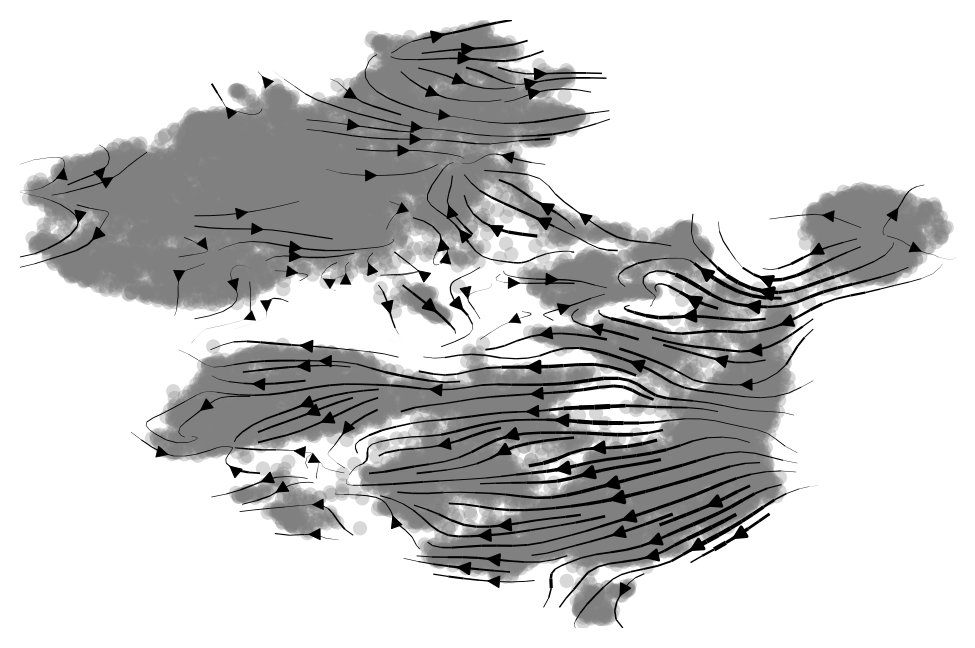

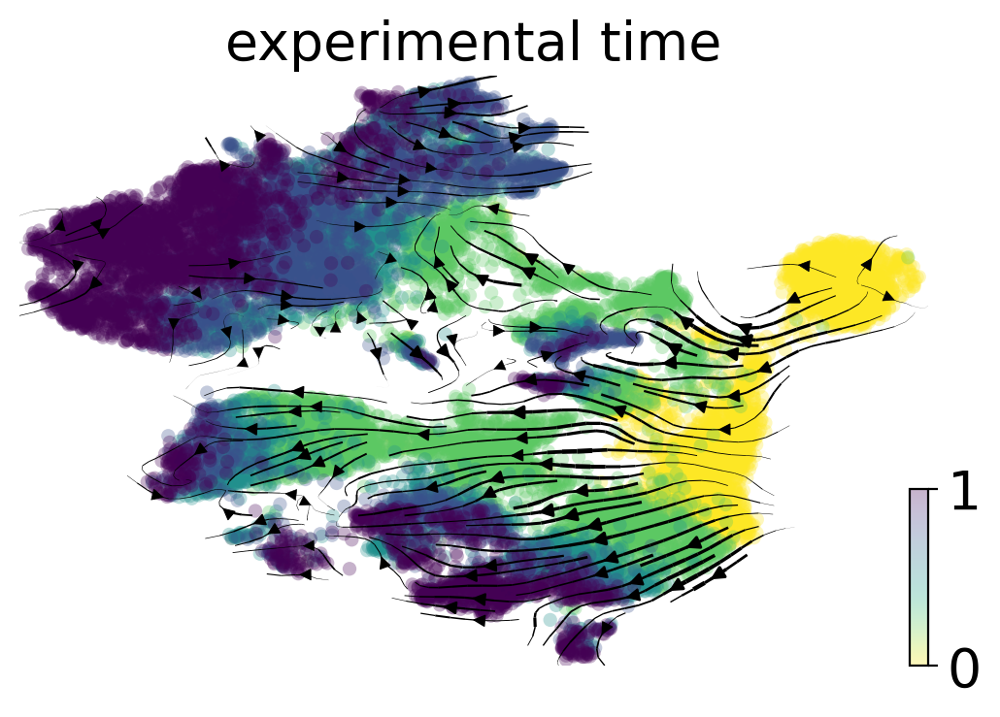

In [159]:
vk_vae_umap = compute_velocity_projection(adata_latent_vae, "X_latents", "velocity")
vk_vae_umap.compute_transition_matrix().plot_projection()
scv.pl.velocity_embedding_stream(adata_latent_vae, vkey="T_fwd", basis="umap", color="experimental_time")

  0%|          | 0/18176 [00:00<?, ?cell/s]

  0%|          | 0/18176 [00:00<?, ?cell/s]

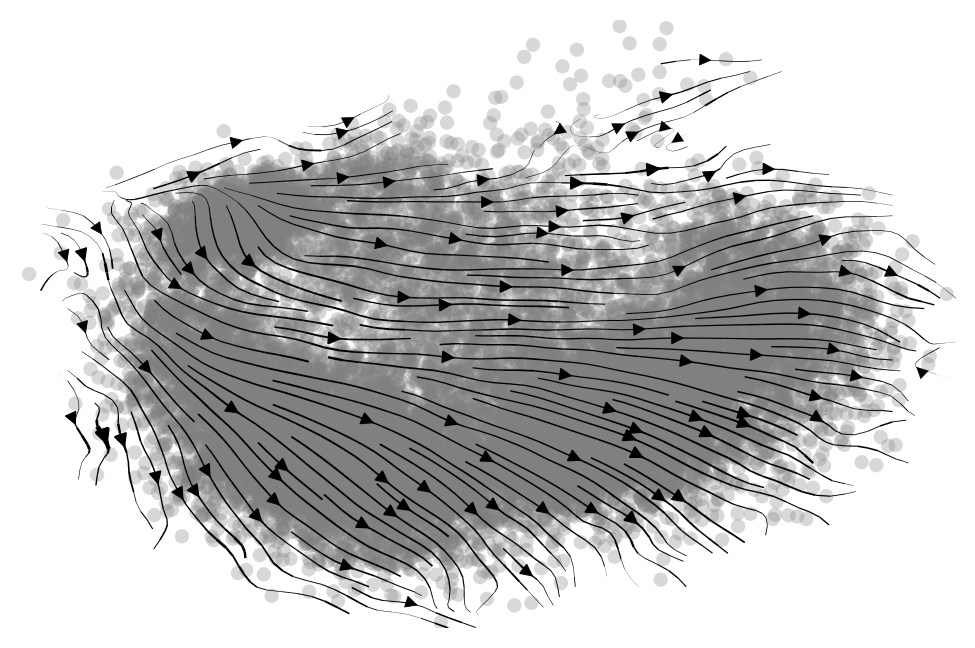

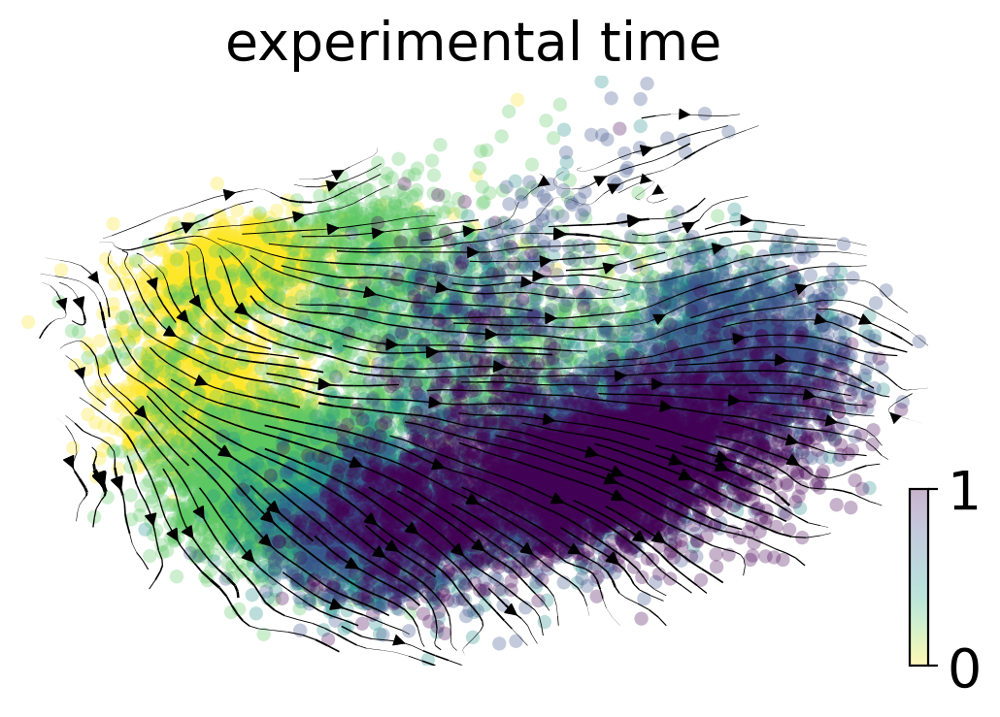

In [160]:
vk_vae_pca = compute_velocity_projection(adata_latent_vae, "X_latents", "velocity")
vk_vae_umap.compute_transition_matrix().plot_projection(basis="pca")
scv.pl.velocity_embedding_stream(adata_latent_vae, vkey="T_fwd", basis="pca", color="experimental_time")

Geometric

  0%|          | 0/18176 [00:00<?, ?cell/s]

  0%|          | 0/18176 [00:00<?, ?cell/s]

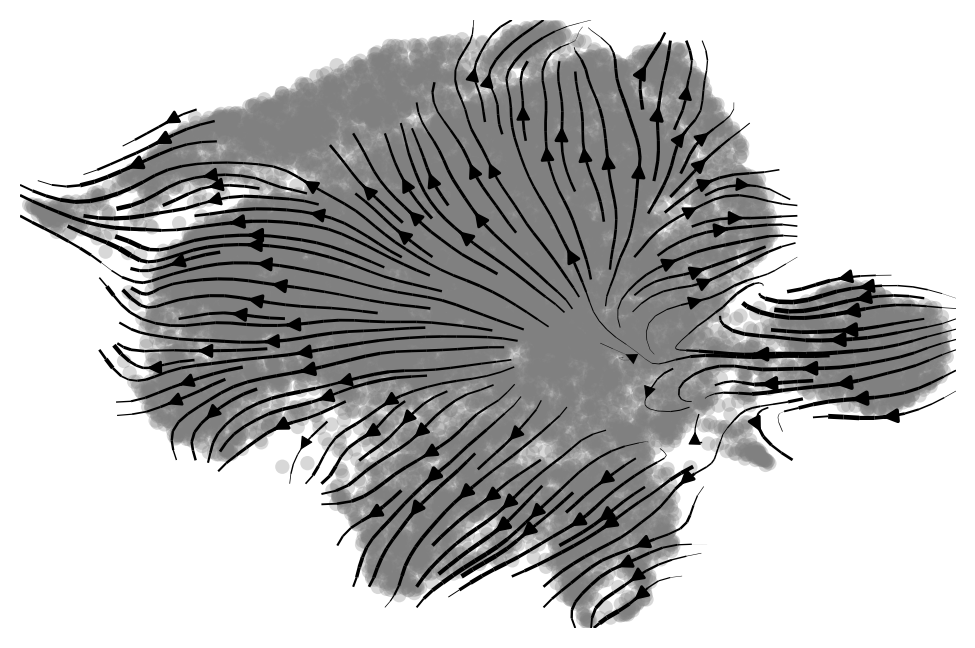

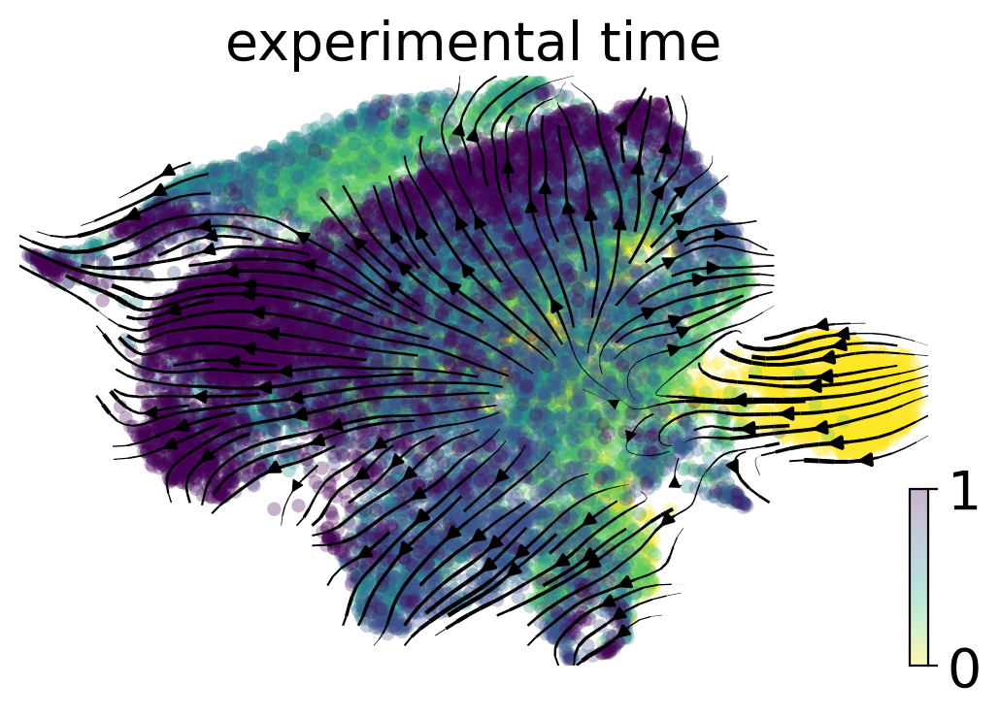

In [161]:
vk_flat_umap = compute_velocity_projection(adata_latent_flat, "X_latents", "velocity")
vk_flat_umap.compute_transition_matrix().plot_projection(basis="umap")
scv.pl.velocity_embedding_stream(adata_latent_flat, vkey="T_fwd", basis="umap", color="experimental_time")

  0%|          | 0/18176 [00:00<?, ?cell/s]

  0%|          | 0/18176 [00:00<?, ?cell/s]

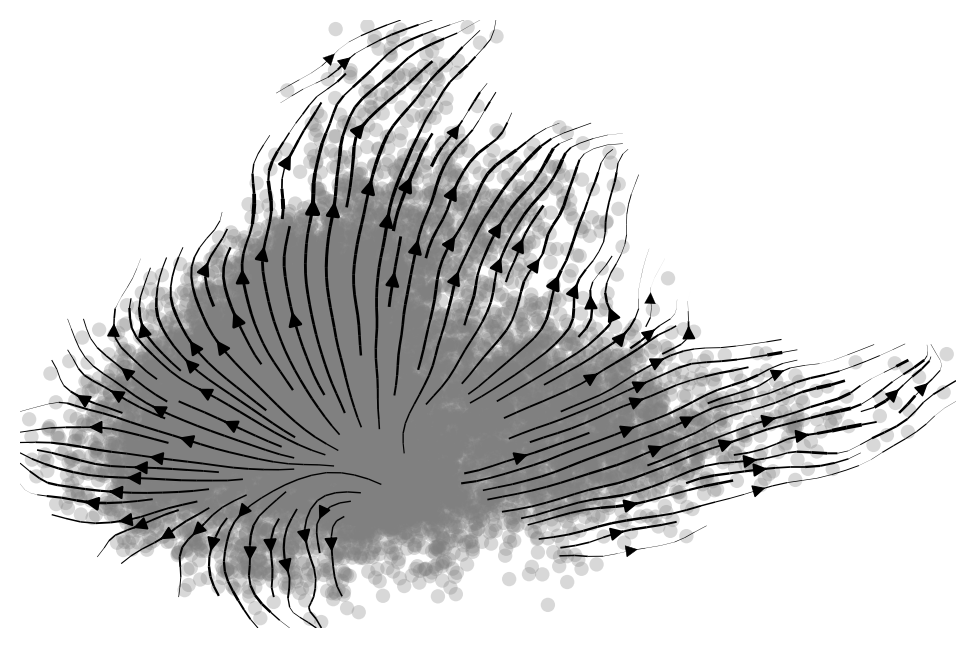

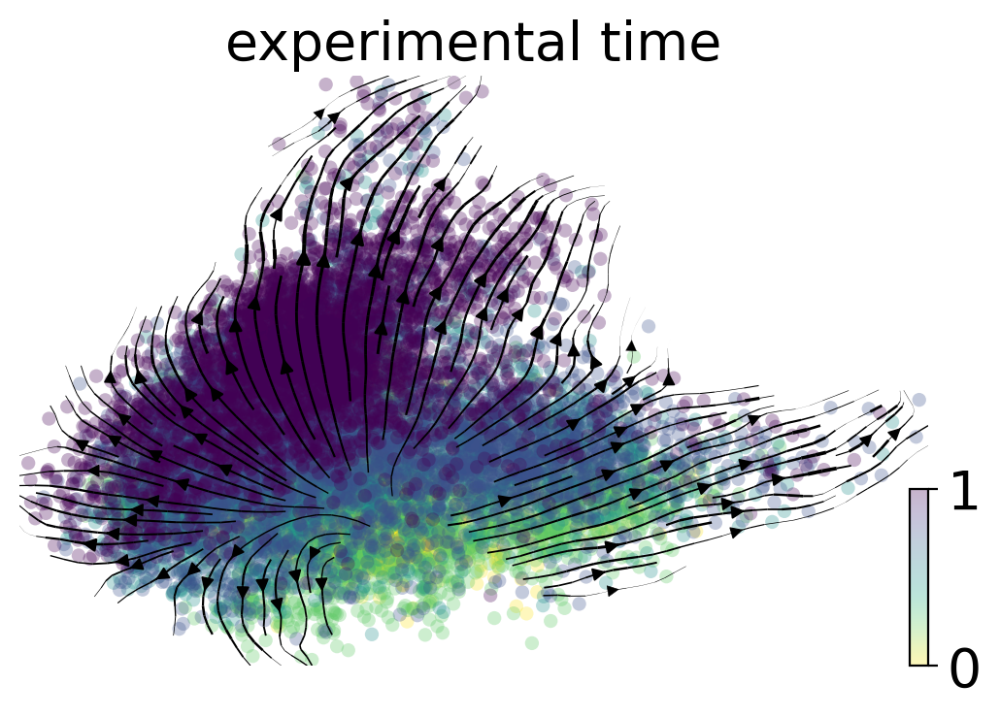

In [162]:
vk_flat_pca = compute_velocity_projection(adata_latent_flat, "X_latents", "velocity")
vk_flat_pca.compute_transition_matrix().plot_projection(basis="pca")
scv.pl.velocity_embedding_stream(adata_latent_flat, vkey="T_fwd", basis="pca", color="experimental_time")

**Geodesic**

  0%|          | 0/18176 [00:00<?, ?cell/s]

  0%|          | 0/18176 [00:00<?, ?cell/s]

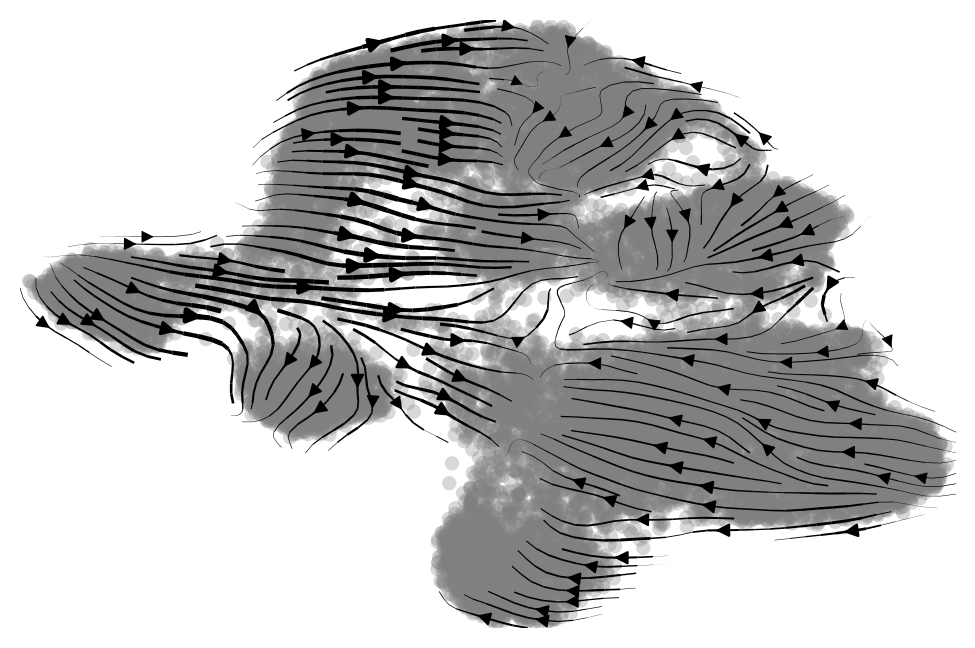

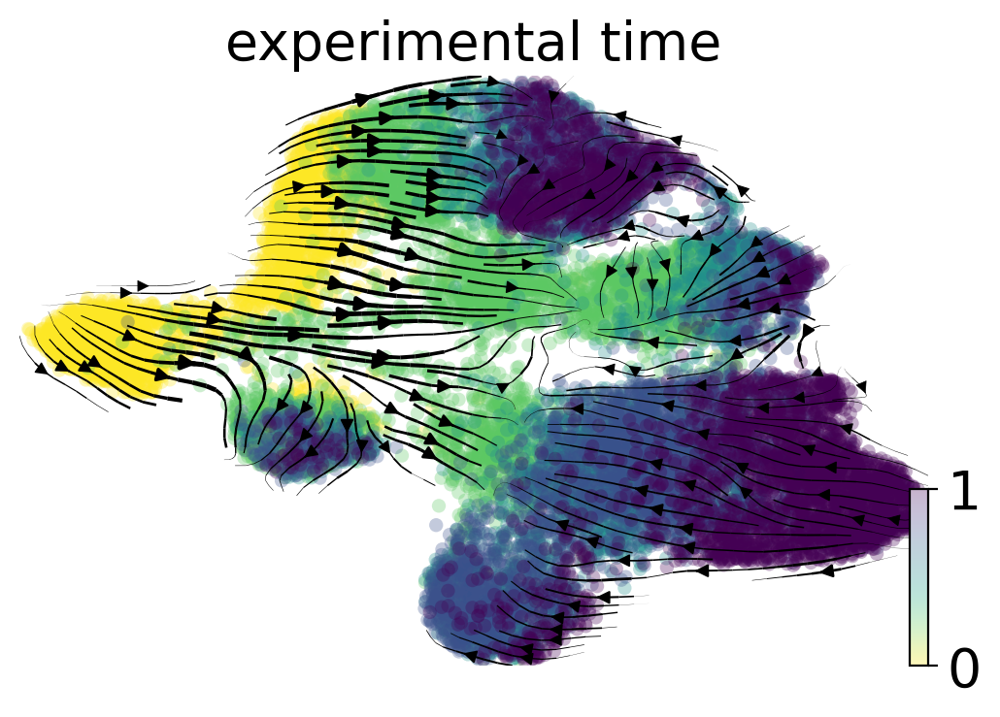

In [163]:
vk_geodesic_umap = compute_velocity_projection(adata_latent_geodesic, "X_latents", "velocity")
vk_geodesic_umap.compute_transition_matrix().plot_projection(basis="umap")
scv.pl.velocity_embedding_stream(adata_latent_geodesic, vkey="T_fwd", basis="umap", color="experimental_time")

  0%|          | 0/18176 [00:00<?, ?cell/s]

  0%|          | 0/18176 [00:00<?, ?cell/s]

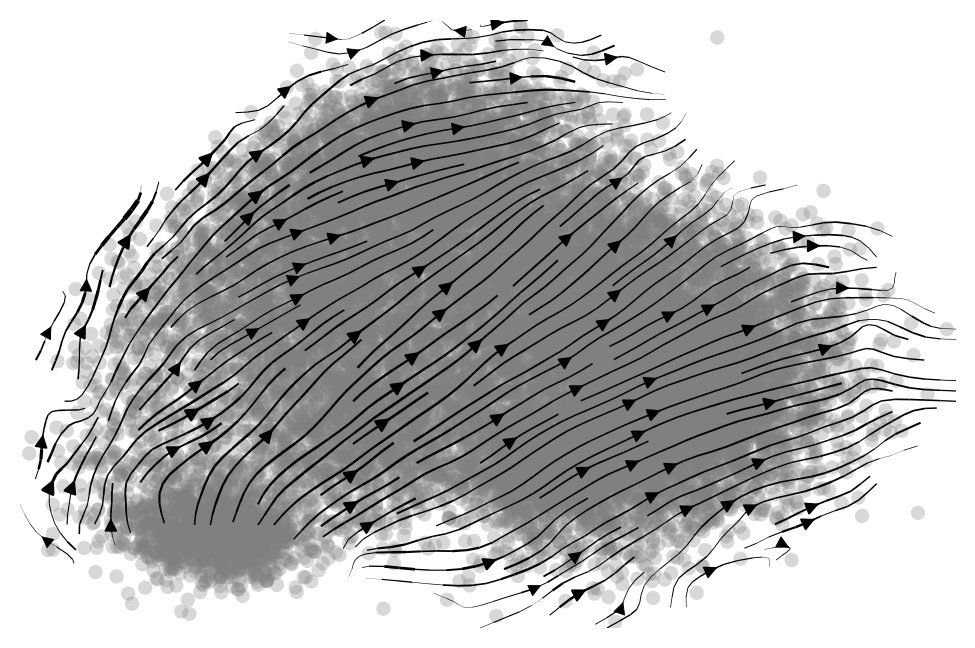

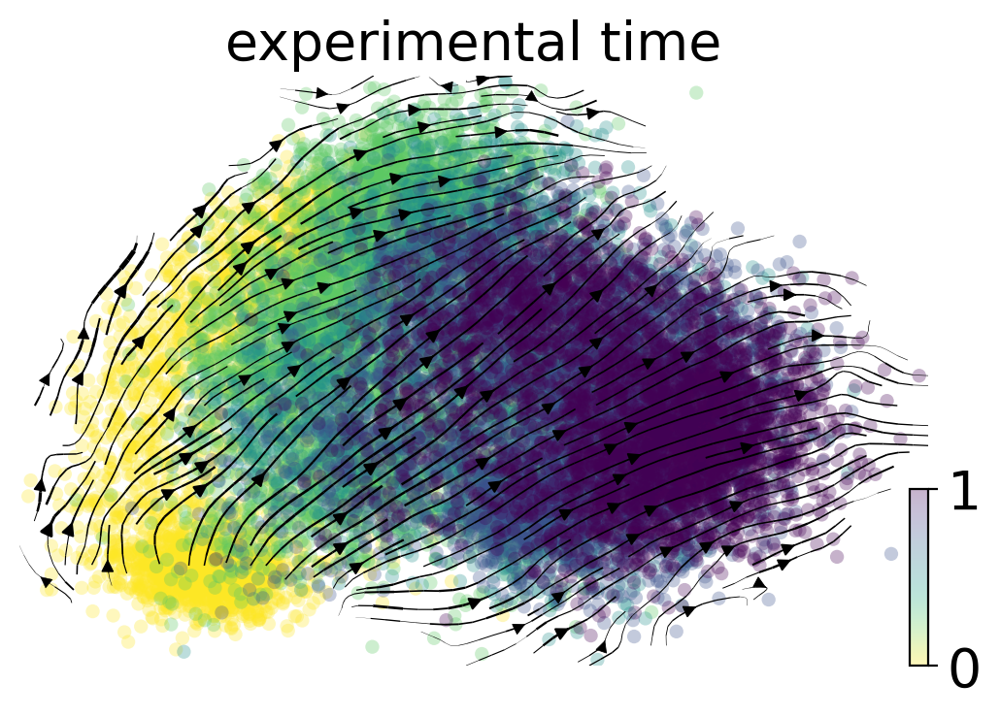

In [164]:
vk_geodesic_pca = compute_velocity_projection(adata_latent_geodesic, "X_latents", "velocity")
vk_geodesic_pca.compute_transition_matrix().plot_projection(basis="pca")
scv.pl.velocity_embedding_stream(adata_latent_geodesic, vkey="T_fwd", basis="pca", color="experimental_time")

**Evaluate push forward from time 0**

In [165]:
#Pick time 0 observations
X_adata_t0_vae = torch.from_numpy(adata_latent_vae[adata_latent_vae.obs["experimental_time"]==0].X).to(device)
X_adata_t0_flat = torch.from_numpy(adata_latent_flat[adata_latent_flat.obs["experimental_time"]==0].X).to(device)
X_adata_t0_geodesic = torch.from_numpy(adata_latent_geodesic[adata_latent_geodesic.obs["experimental_time"]==0].X).to(device)

#Library values of observations at time 0
l_t0_vae = adata_latent_vae.obs.loc[adata_latent_vae.obs["experimental_time"]==0, "log_library_size"].to_numpy()
l_t0_flat = adata_latent_flat.obs.loc[adata_latent_flat.obs["experimental_time"]==0, "log_library_size"].to_numpy()
l_t0_geodesic = adata_latent_geodesic.obs.loc[adata_latent_geodesic.obs["experimental_time"]==0, "log_library_size"].to_numpy()
l_t0_vae = torch.from_numpy(l_t0_vae).to(device)
l_t0_flat = torch.from_numpy(l_t0_flat).to(device)
l_t0_geodesic = torch.from_numpy(l_t0_geodesic).to(device)

In [166]:
# Collect latent trajectories
traj_vae, times_vae = compute_trajectory(X_adata_t0_vae, 
                                         l_t0_vae,
                                         cfm_vae, 
                                         idx2time, 
                                         device, 
                                         use_real_time=False)

traj_flat, times_flat = compute_trajectory(X_adata_t0_flat, 
                                           l_t0_flat,
                                           cfm_flat, 
                                           idx2time, 
                                           device, 
                                           use_real_time=False)

traj_geodesic, times_geodesic = compute_trajectory(X_adata_t0_geodesic, 
                                           l_t0_geodesic,
                                           cfm_geodesic, 
                                           idx2time, 
                                           device, 
                                           use_real_time=False)

# Convert times to data frames to put them into the anndata object 
times_vae = pd.DataFrame(times_vae)
times_flat = pd.DataFrame(times_flat)
times_geodesic = pd.DataFrame(times_geodesic)
times_vae.columns = ["experimental_time"]
times_flat.columns = ["experimental_time"]
times_geodesic.columns = ["experimental_time"]

Create trajectory anndata

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


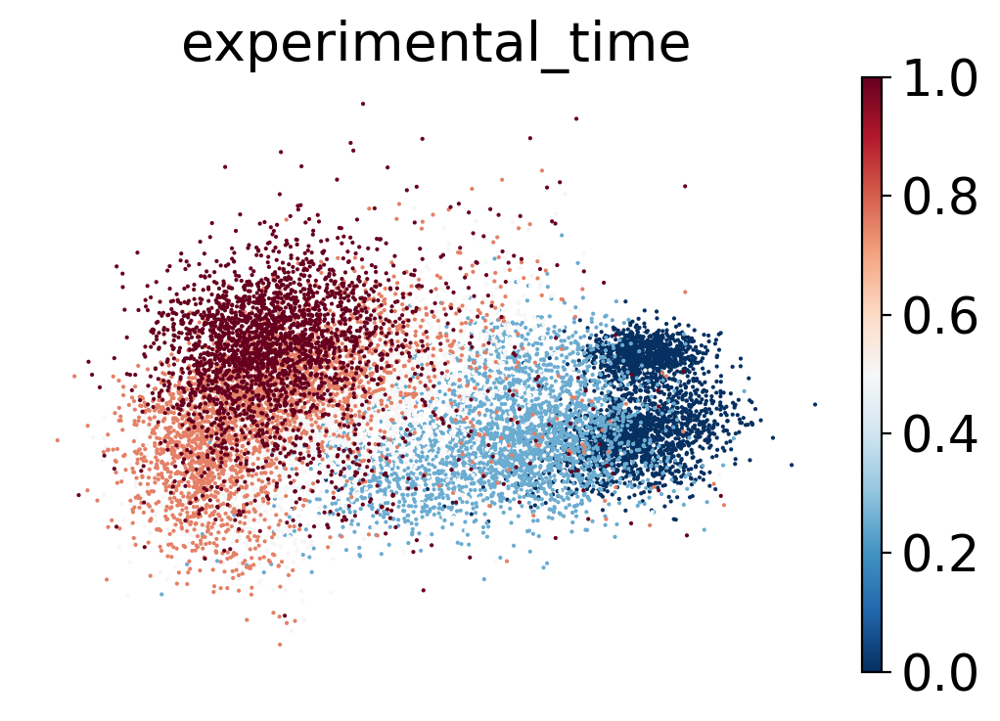

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


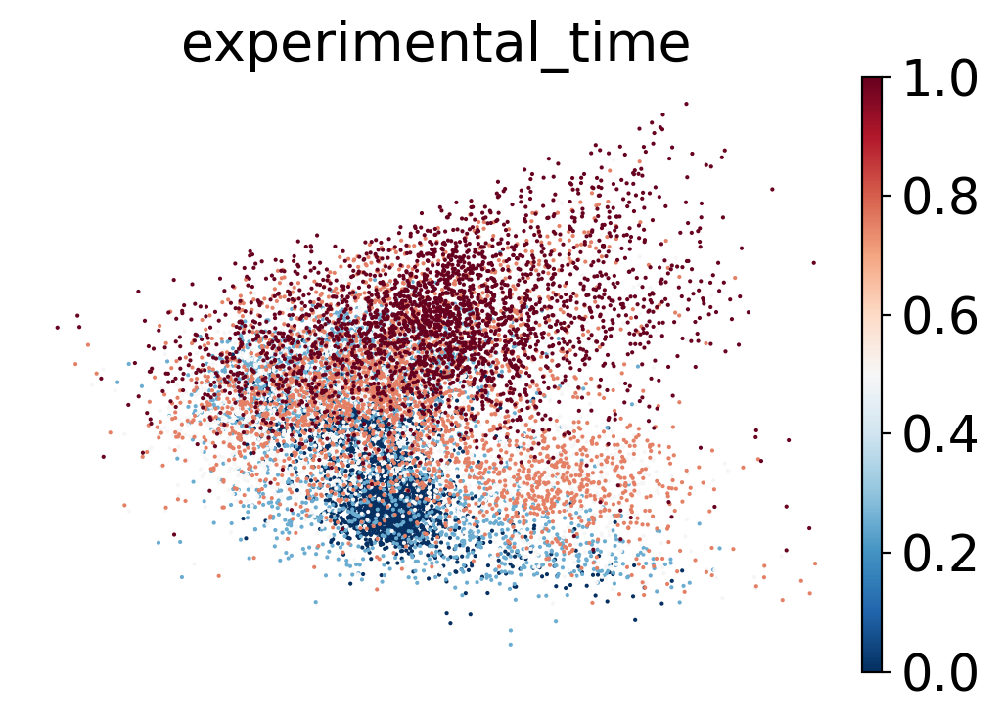

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


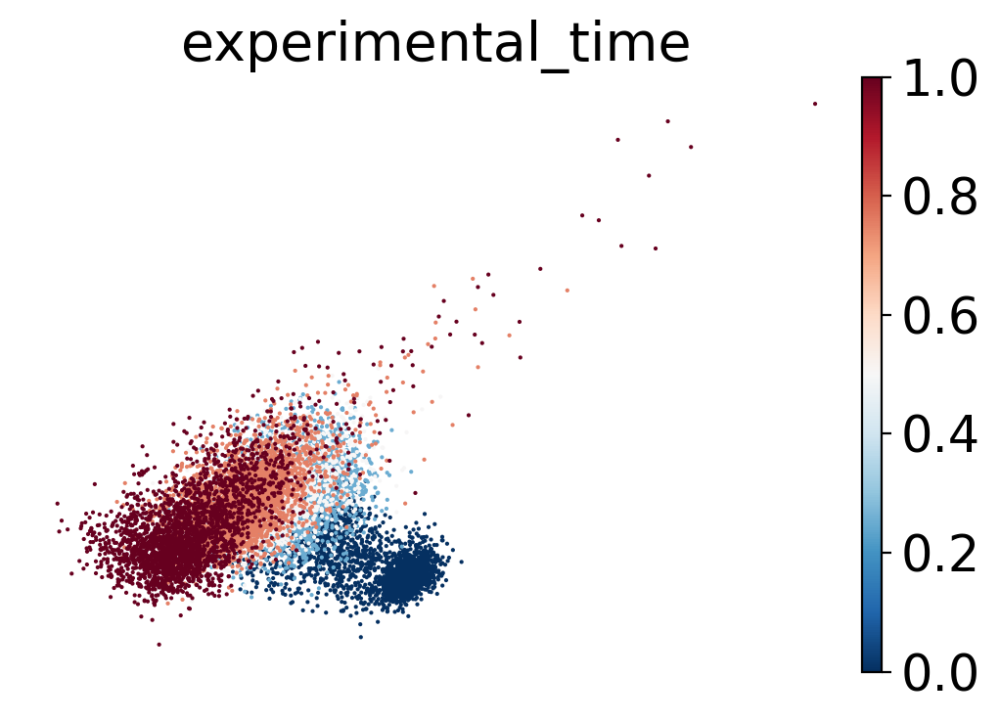

In [167]:
# Adata simulated non-flat
adata_simulated_vae = anndata.AnnData(X=traj_vae.detach().numpy(), 
                                     obs=times_vae)
sc.tl.pca(adata_simulated_vae)
sc.pl.pca(adata_simulated_vae, color="experimental_time")

# Adata simulated flat
adata_simulated_flat = anndata.AnnData(X=traj_flat.detach().numpy(),
                                      obs=times_flat)
sc.tl.pca(adata_simulated_flat)
sc.pl.pca(adata_simulated_flat, color="experimental_time")

# Adata simulated geodeisc
adata_simulated_geodesic = anndata.AnnData(X=traj_geodesic.detach().numpy(),
                                      obs=times_geodesic)
sc.tl.pca(adata_simulated_geodesic)
sc.pl.pca(adata_simulated_geodesic, color="experimental_time")

In [168]:
# UMAP simulated non-flat
sc.pp.neighbors(adata_simulated_vae, 30)
sc.tl.umap(adata_simulated_vae)

# UMAP simulated flat
sc.pp.neighbors(adata_simulated_flat, 30)
sc.tl.umap(adata_simulated_flat)

# UMAP simulated geodesic
sc.pp.neighbors(adata_simulated_geodesic, 30)
sc.tl.umap(adata_simulated_geodesic)

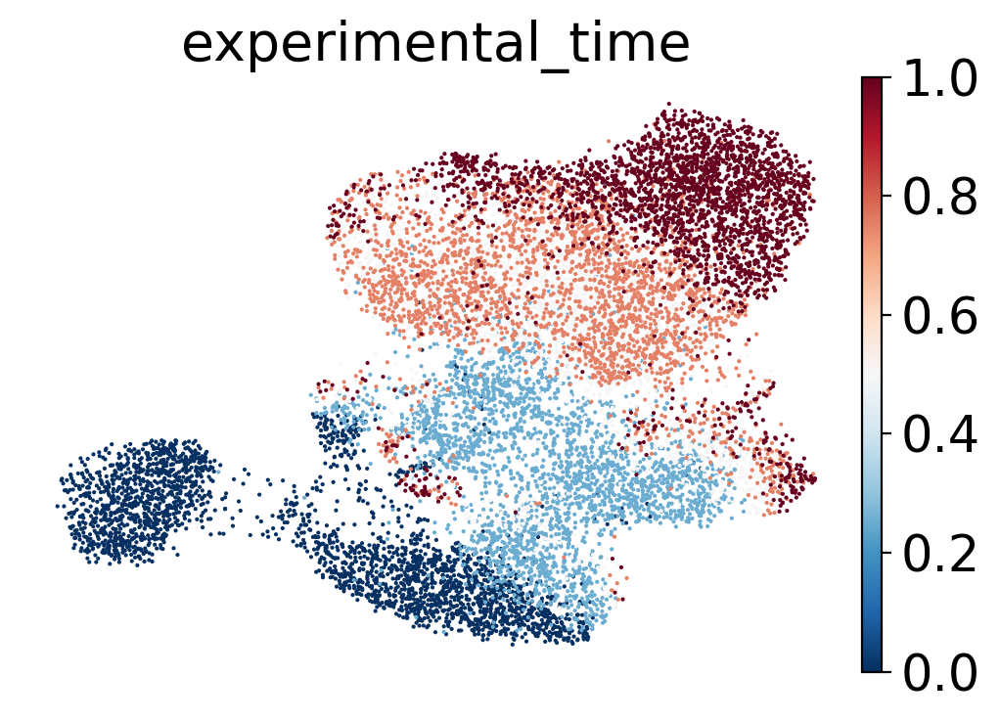

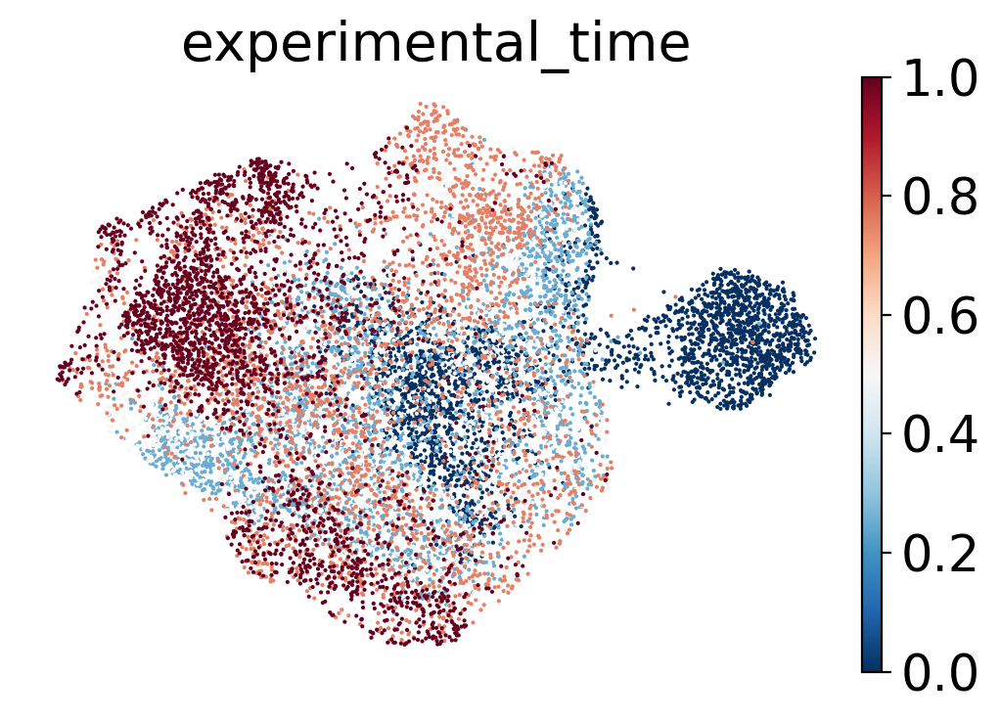

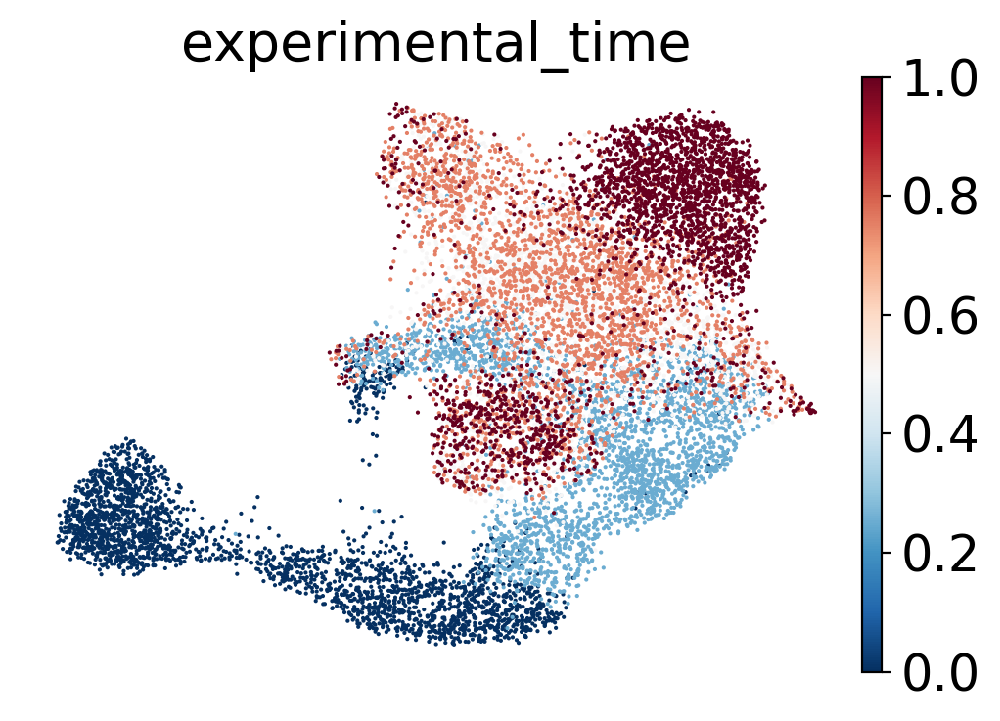

In [169]:
# Plot results
sc.pl.umap(adata_simulated_vae, color = "experimental_time")
sc.pl.umap(adata_simulated_flat, color = "experimental_time")
sc.pl.umap(adata_simulated_geodesic, color = "experimental_time")

In [170]:
# Concatenate simulated and real distributions non-flat vae
concat_vae = anndata.concat([adata_simulated_vae, adata_latent_vae])
dataset_type = ["simulated" for i in range(len(adata_simulated_vae))] + ["real" for i in range(len(adata_latent_vae))]
concat_vae.obs["dataset_type"] = dataset_type

# Concatenate simulated and real distributions flat vae
concat_flat = anndata.concat([adata_simulated_flat, adata_latent_flat])
dataset_type = ["simulated" for i in range(len(adata_simulated_flat))] + ["real" for i in range(len(adata_latent_flat))]
concat_flat.obs["dataset_type"] = dataset_type

# Concatenate simulated and real distributions geodesic vae
concat_geodesic = anndata.concat([adata_simulated_geodesic, adata_latent_geodesic])
dataset_type = ["simulated" for i in range(len(adata_simulated_geodesic))] + ["real" for i in range(len(adata_latent_geodesic))]
concat_geodesic.obs["dataset_type"] = dataset_type

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


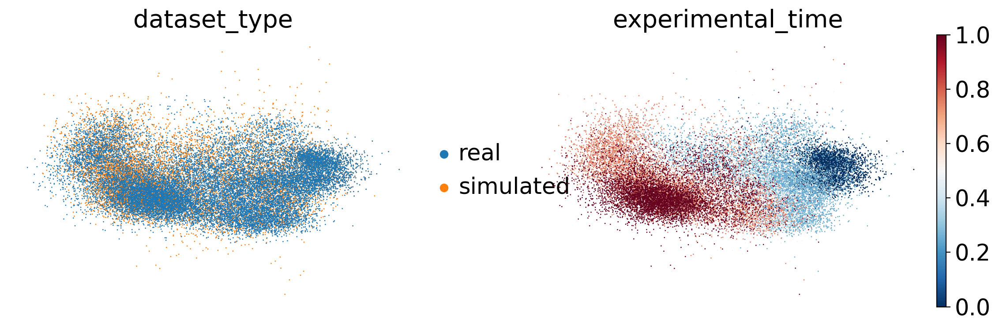

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


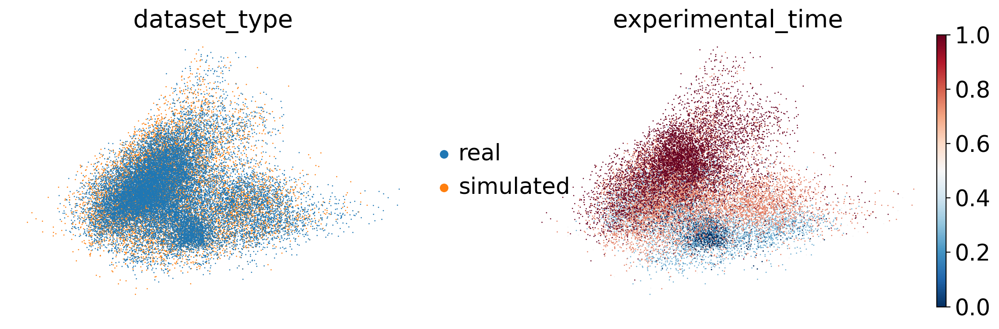

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


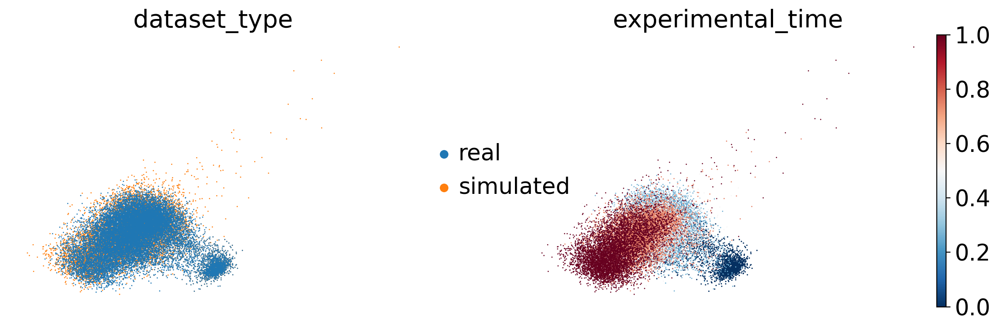

In [171]:
# PCA comparison simulated/real non-flat
sc.pp.pca(concat_vae)
sc.pl.pca(concat_vae, color=["dataset_type","experimental_time"])

# PCA comparison simulated/real flat
sc.pp.pca(concat_flat)
sc.pl.pca(concat_flat, color=["dataset_type","experimental_time"])

# PCA comparison simulated/real geodesic
sc.pp.pca(concat_geodesic)
sc.pl.pca(concat_geodesic, color=["dataset_type","experimental_time"])

In [172]:
# UMAP comparison simulated/real non-flat
sc.pp.neighbors(concat_vae, 30)
sc.tl.umap(concat_vae)

# UMAP comparison simulated/real flat
sc.pp.neighbors(concat_flat, 30)
sc.tl.umap(concat_flat)

# UMAP comparison simulated/real geodesic
sc.pp.neighbors(concat_geodesic, 30)
sc.tl.umap(concat_geodesic)

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


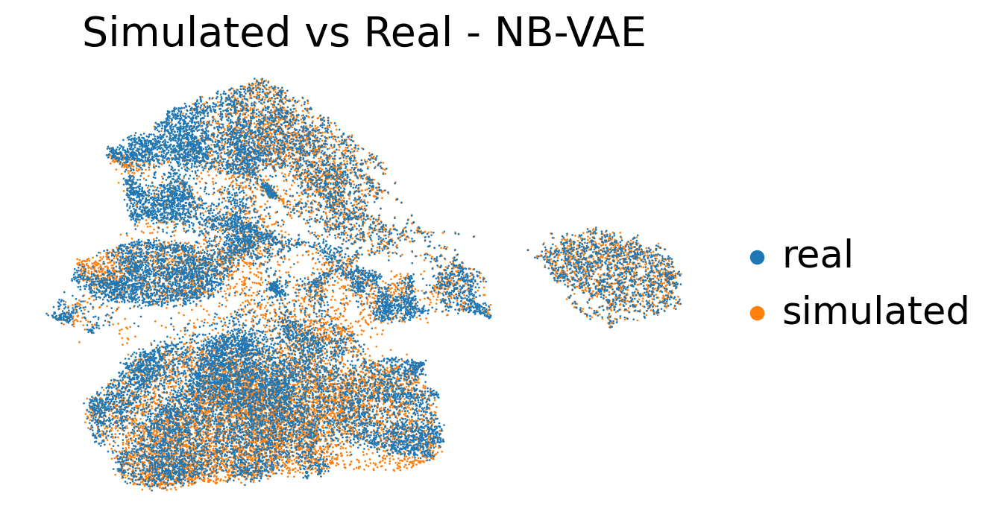

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


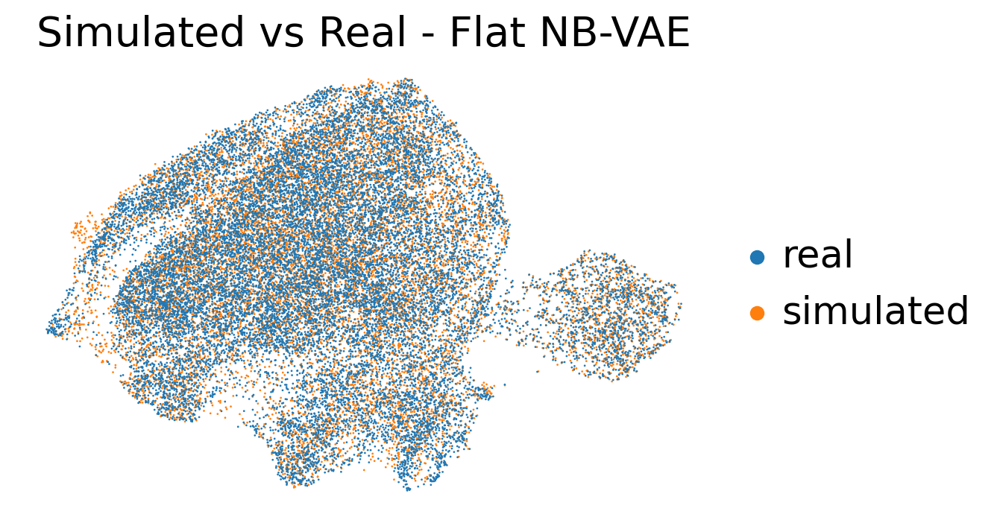

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


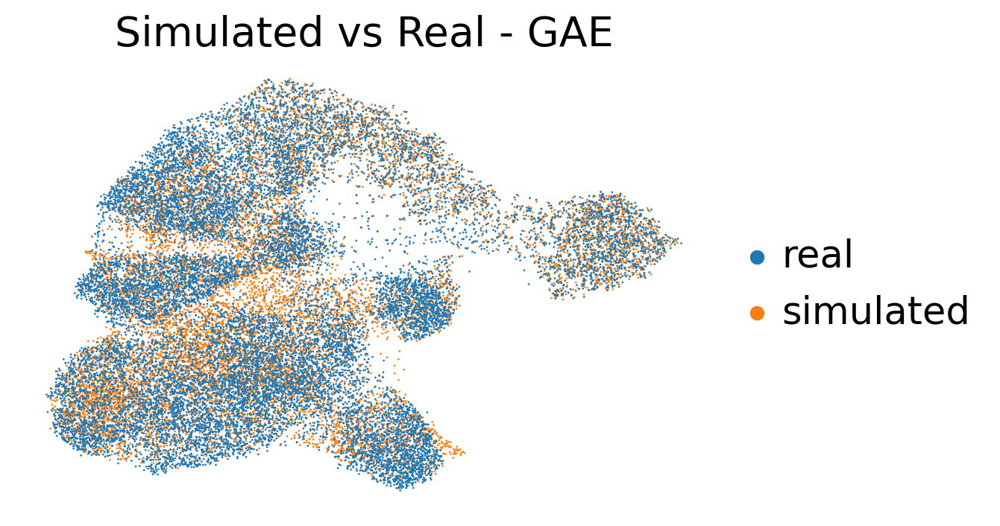

In [173]:
# Plot UMAP comparison simulated/real non-flat
sc.settings.figdir = str("/home/icb/alessandro.palma/")

sc.pl.umap(concat_vae, color = ["dataset_type"], title="Simulated vs Real - NB-VAE", 
           save="nb_vae_sim.svg")

# Plot UMAP comparison simulated/real flat
sc.pl.umap(concat_flat, color = ["dataset_type"], title="Simulated vs Real - Flat NB-VAE",
          save="flat_nb_vae_sim.svg")

# Plot UMAP comparison simulated/real geodesic
sc.pl.umap(concat_geodesic, color = ["dataset_type"], title="Simulated vs Real - GAE",
          save="geodesic_nb_vae_sim.svg")

**Decoded trajectories**

In [174]:
datamodule={'path': DATA_DIR / "eb" / "processed" / "eb_phate.h5ad", 
            'x_layer': 'X_norm', 
            'cond_keys': ['experimental_time', 'leiden'],
            'use_pca': False, 
            'n_dimensions': None, 
            'train_val_test_split': [1], 
            'batch_size': 512, 
            'num_workers': 2}

# Initialize datamodule
datamodule = scDataModule(**datamodule)

Initialize variational autoencoders

In [175]:
vae_kwargs={'in_dim': datamodule.in_dim,
       'n_epochs_anneal_kl': 1000, 
       'kl_weight': None, 
       'likelihood': 'nb', 
       'dropout': False, 
       'learning_rate': 0.001, 
       'dropout_p': False, 
       'model_library_size': True, 
       'batch_norm': True, 
       'kl_warmup_fraction': 0.1, 
       'hidden_dims': [256, 10]}
        
geometric_kwargs={'compute_metrics_every': 1, 
                   'use_c': False, 
                   'trainable_c': False,
                   'l2': True, 
                   'eta_interp': 0, 
                   'interpolate_z': False, 
                   'start_jac_after': 0, 
                   'fl_weight': 0.1,
                   'detach_theta': True}

geodesic_kwargs={"in_dim": datamodule.in_dim,
                  "hidden_dims": [256, 10],
                  "batch_norm": True,
                  "dropout": False, 
                  "dropout_p": False,
                  "likelihood": "nb",
                  "learning_rate": 0.001}

In [176]:
# Initialize vae and geometric vae
vae = GeometricNBVAE(**geometric_kwargs, vae_kwargs=vae_kwargs).to(device)
geometric_vae = GeometricNBVAE(**geometric_kwargs, vae_kwargs=vae_kwargs).to(device)
geodesic_ae = GeodesicAE(**geodesic_kwargs).to(device)

In [177]:
# Load state dicts and put in eval mode 
vae.load_state_dict(torch.load("/home/icb/alessandro.palma/environment/scCFM/project_dir/checkpoints/ae/eb/best_model_vae_lib.ckpt")["state_dict"])
geometric_vae.load_state_dict(torch.load("/home/icb/alessandro.palma/environment/scCFM/project_dir/checkpoints/ae/eb/best_model_geometric_lib.ckpt")["state_dict"])
geodesic_ae.load_state_dict(torch.load("/home/icb/alessandro.palma/environment/scCFM/project_dir/checkpoints/ae/eb/best_model_geodesic_ae.ckpt")["state_dict"])

<All keys matched successfully>

Compute the trajectories 

In [178]:
# Collect data trajectories
mu_traj_vae, x_traj_vae, times_traj_vae = decode_trajectory(X_adata_t0_vae,
                                                            l_t0_vae,
                                                            cfm_vae,
                                                            vae,
                                                            idx2time, 
                                                            device, 
                                                            False)

mu_traj_flat, x_traj_flat, times_traj_flat = decode_trajectory(X_adata_t0_flat,
                                                               l_t0_flat,
                                                               cfm_flat,
                                                               geometric_vae,
                                                               idx2time, 
                                                               device, 
                                                               False)

mu_traj_geodesic, x_traj_geodesic, times_traj_geodesic = decode_trajectory(X_adata_t0_geodesic,
                                                                               l_t0_geodesic,
                                                                               cfm_geodesic,
                                                                               geodesic_ae,
                                                                               idx2time, 
                                                                               device, 
                                                                               use_real_time=False, 
                                                                               append_last=True,
                                                                               keep_time_d=False, 
                                                                               model_type="geodesic_ae")

Assemble the trajectories into anndata files

In [179]:
# Real time cells (for plotting)
times_traj_vae = pd.DataFrame(times_traj_vae)
times_traj_flat = pd.DataFrame(times_traj_flat)
times_traj_geodesic = pd.DataFrame(times_traj_geodesic)

times_traj_vae.columns = ["experimental_time"]
times_traj_flat.columns = ["experimental_time"]
times_traj_geodesic.columns = ["experimental_time"]

# Create anndatas
adata_x_traj_vae = anndata.AnnData(X=x_traj_vae.detach().numpy(), 
                                     obs=times_traj_vae)
adata_x_traj_flat = anndata.AnnData(X=x_traj_flat.detach().numpy(),
                                      obs=times_traj_flat)
adata_x_traj_geodesic = anndata.AnnData(X=x_traj_geodesic.detach().numpy(),
                                      obs=times_traj_geodesic)

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


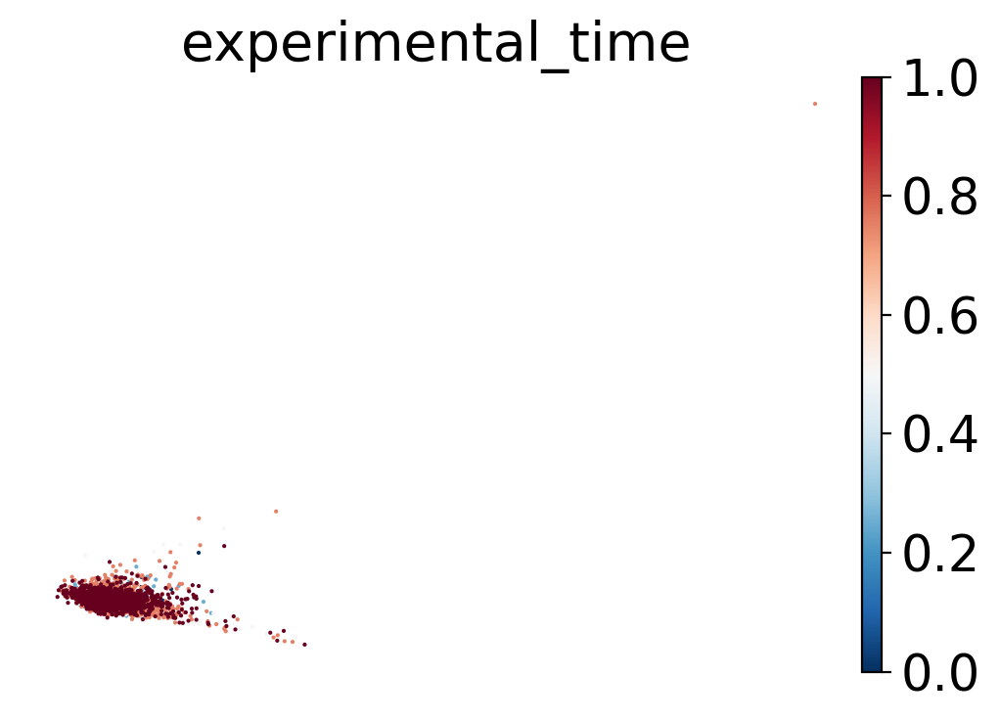

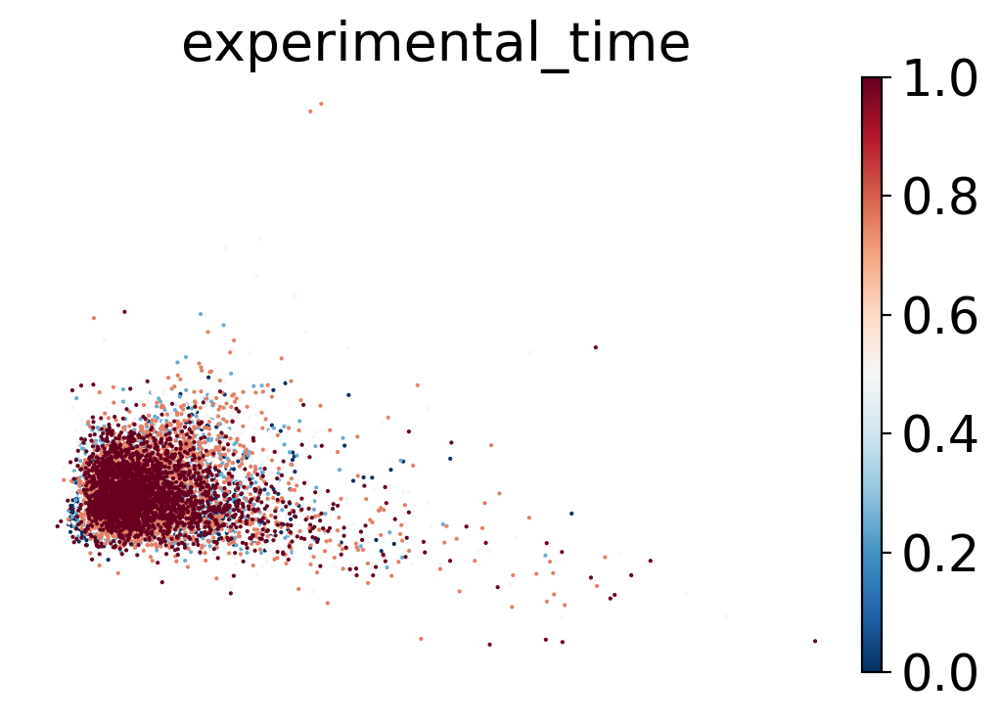

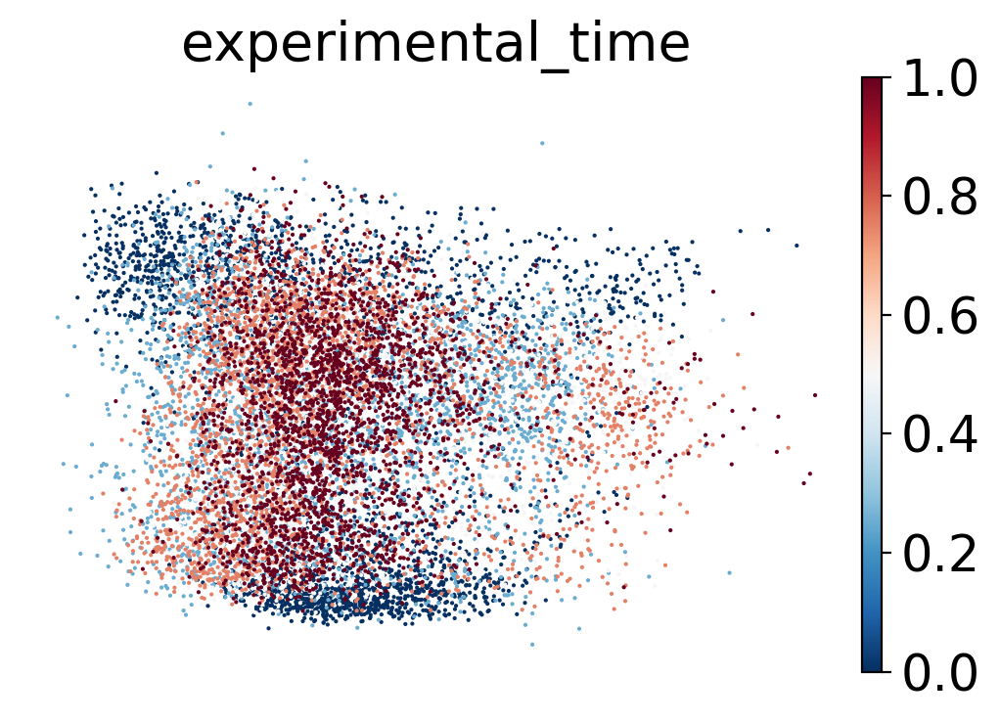

In [180]:
# PCA decoded trajectories VAE
sc.pp.pca(adata_x_traj_vae)
sc.pl.pca(adata_x_traj_vae, color=["experimental_time"])

# PCA decoded trajectories flat VAE
sc.pp.pca(adata_x_traj_flat)
sc.pl.pca(adata_x_traj_flat, color=["experimental_time"])\

# PCA decoded trajectories geodesic AE
sc.pp.pca(adata_x_traj_geodesic)
sc.pl.pca(adata_x_traj_geodesic, color=["experimental_time"])

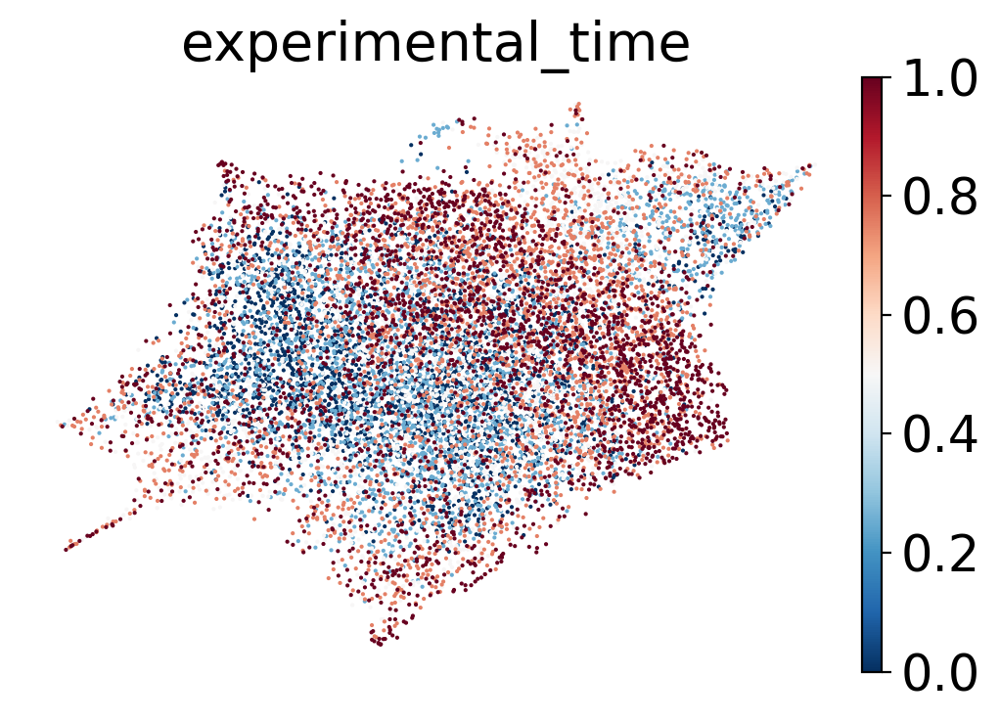

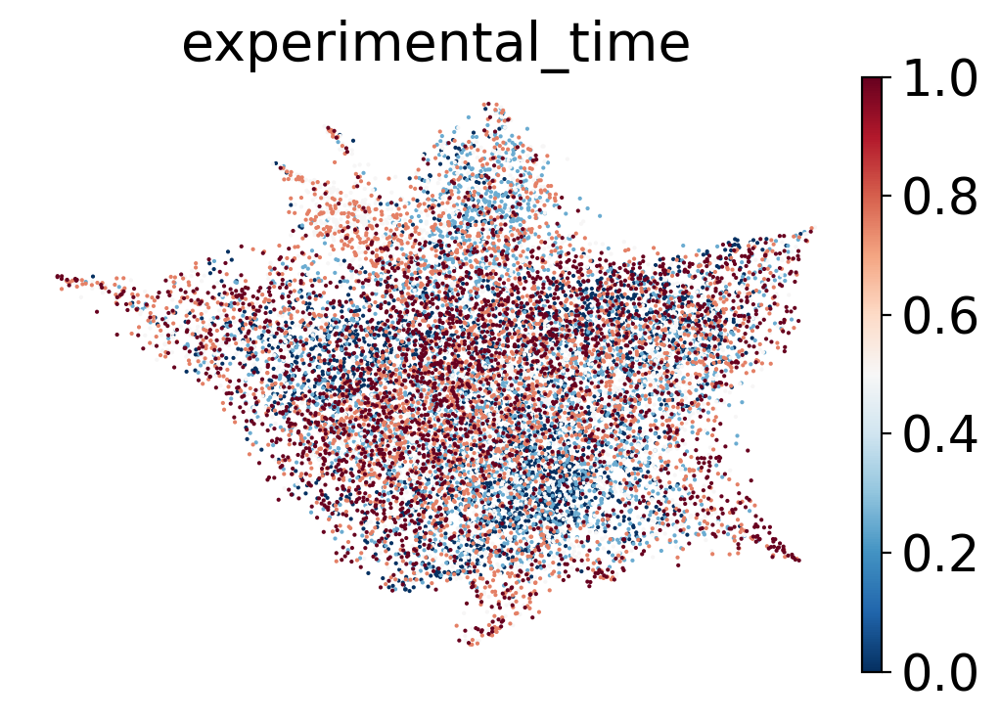

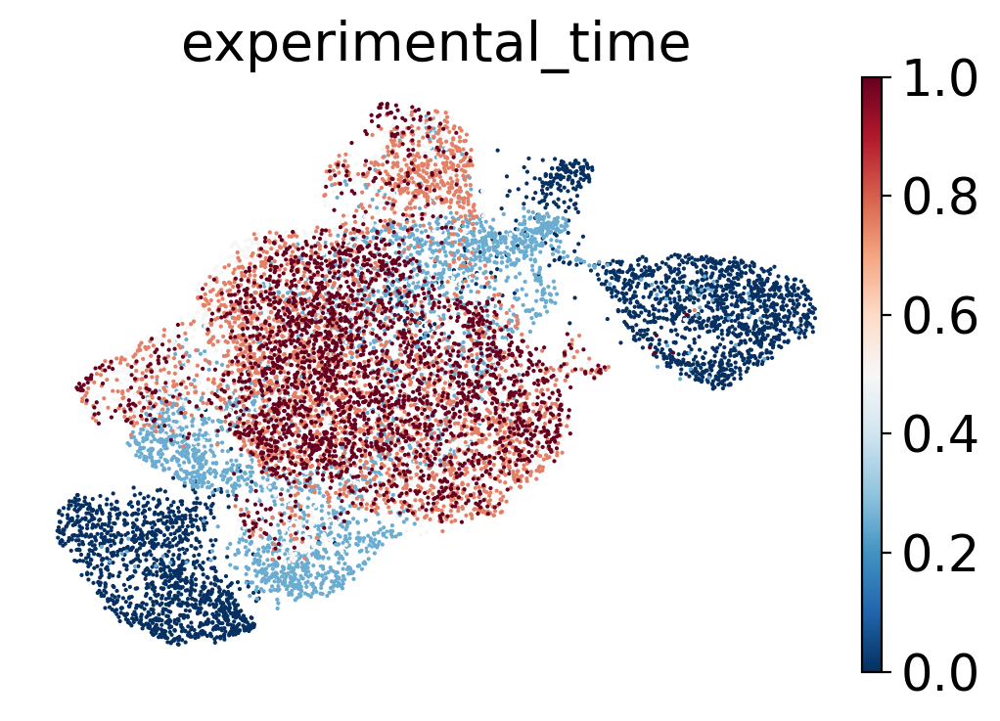

In [181]:
# UMAP decoded trajectories VAE
sc.pp.neighbors(adata_x_traj_vae, 30)
sc.tl.umap(adata_x_traj_vae)
sc.pl.umap(adata_x_traj_vae, color = ["experimental_time"])

# UMAP decoded trajectories flat VAE
sc.pp.neighbors(adata_x_traj_flat, 30)
sc.tl.umap(adata_x_traj_flat)
sc.pl.umap(adata_x_traj_flat, color = ["experimental_time"])

# UMAP decoded trajectories GAE
sc.pp.neighbors(adata_x_traj_geodesic, 30)
sc.tl.umap(adata_x_traj_geodesic)
sc.pl.umap(adata_x_traj_geodesic, color = ["experimental_time"])

Read original data and collect the normalization layer

In [182]:
adata_eb_original = sc.read_h5ad(DATA_DIR / "eb" / "processed" / "eb_phate.h5ad")
adata_eb_original.X = adata_eb_original.layers["X_norm"].copy()

Assemble anndata containing real data and generated data 

In [183]:
# Assign variable names to trajectory datasets
adata_x_traj_vae.var.index = adata_eb_original.var.index
adata_x_traj_flat.var.index = adata_eb_original.var.index
adata_x_traj_geodesic.var.index = adata_eb_original.var.index

# Concatenate real anndata with simulated anndata vae
concat_vae_x = anndata.concat([adata_x_traj_vae, adata_eb_original])
dataset_type = ["simulated" for i in range(len(adata_x_traj_vae))] + ["real" for i in range(len(adata_eb_original))]
concat_vae_x.obs["dataset_type"] = dataset_type

# Concatenate real anndata with simulated anndata flat vae
concat_flat_x = anndata.concat([adata_x_traj_flat, adata_eb_original])
dataset_type = ["simulated" for i in range(len(adata_x_traj_flat))] + ["real" for i in range(len(adata_eb_original))]
concat_flat_x.obs["dataset_type"] = dataset_type

# Concatenate real anndata with simulated anndata geodesic ae
adata_eb_original_log = adata_eb_original.copy()
sc.pp.log1p(adata_eb_original_log)
concat_geodesic_x = anndata.concat([adata_x_traj_geodesic, adata_eb_original_log])
dataset_type = ["simulated" for i in range(len(adata_x_traj_geodesic))] + ["real" for i in range(len(adata_eb_original_log))]
concat_geodesic_x.obs["dataset_type"] = dataset_type

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


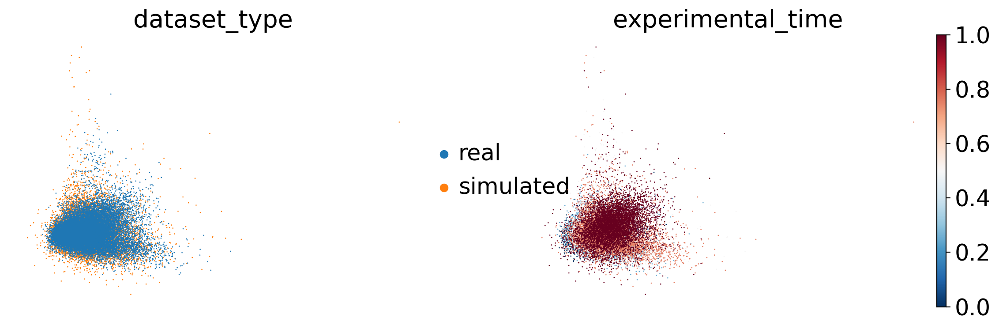

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


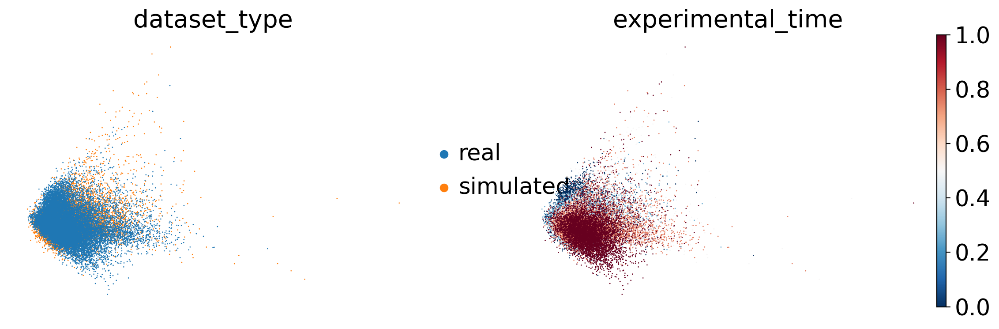

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


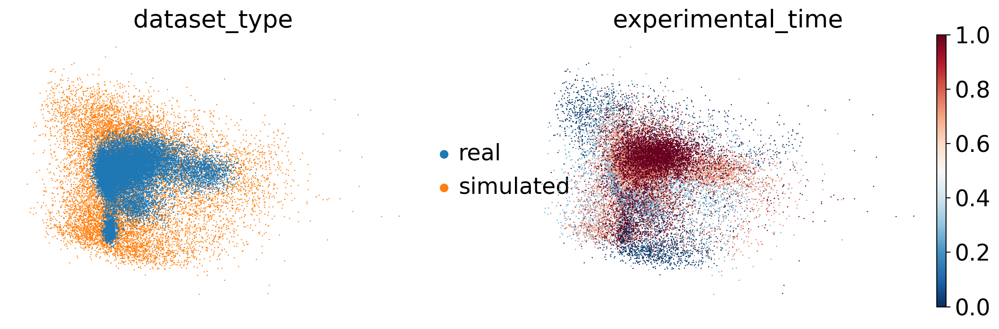

In [184]:
# PCA decoded trajectories real/simulated VAE
sc.pp.pca(concat_vae_x)
sc.pl.pca(concat_vae_x, color=["dataset_type","experimental_time"])

# PCA decoded trajectories real/simulated flat VAE
sc.pp.pca(concat_flat_x)
sc.pl.pca(concat_flat_x, color=["dataset_type","experimental_time"])

# PCA decoded trajectories real/simulated flat VAE
sc.pp.pca(concat_geodesic_x)
sc.pl.pca(concat_geodesic_x, color=["dataset_type","experimental_time"])

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


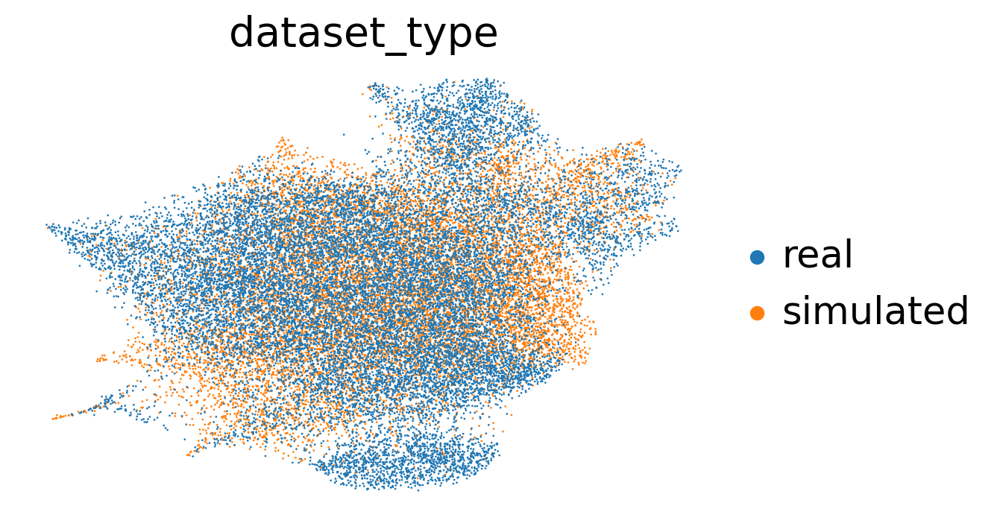

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


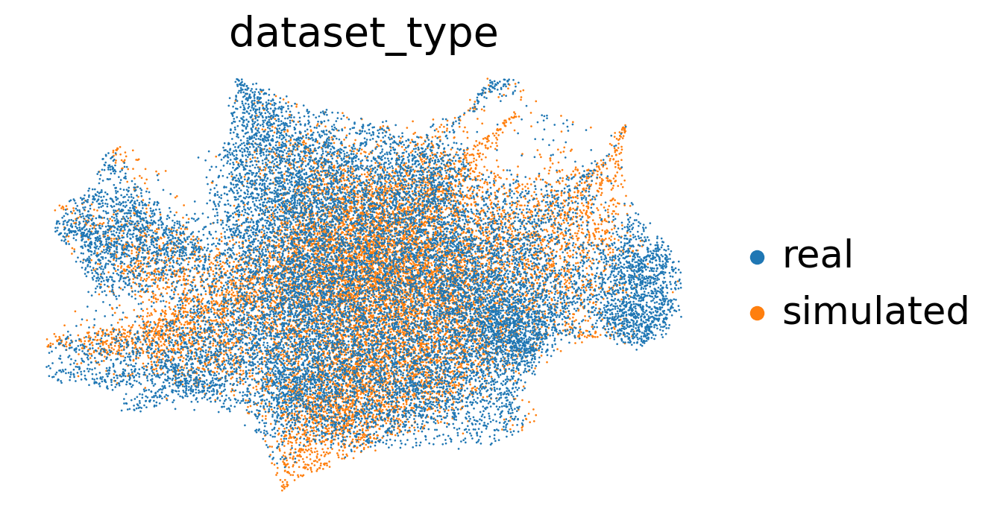

/home/icb/alessandro.palma/miniconda3/envs/scCFM/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


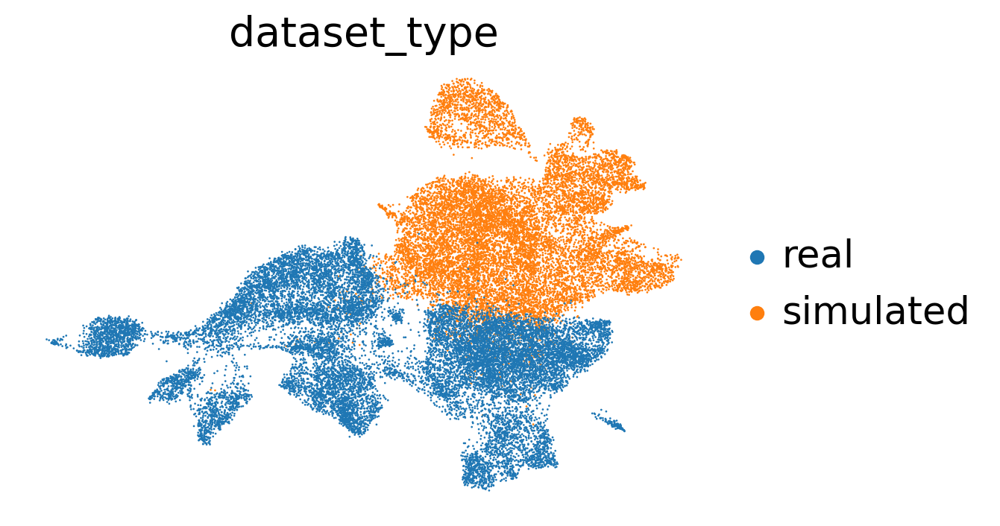

In [185]:
# UMAP decoded trajectories real/simulated VAE
sc.pp.neighbors(concat_vae_x, 30)
sc.tl.umap(concat_vae_x)
sc.pl.umap(concat_vae_x, color = ["dataset_type"])

# UMAP decoded trajectories real/simulated flat VAE
sc.pp.neighbors(concat_flat_x, 30)
sc.tl.umap(concat_flat_x)
sc.pl.umap(concat_flat_x, color = ["dataset_type"])

# UMAP decoded trajectories real/simulated geodesic VAE
sc.pp.neighbors(concat_geodesic_x, 30)
sc.tl.umap(concat_geodesic_x)
sc.pl.umap(concat_geodesic_x, color = ["dataset_type"])

**Check latent distribution reconstruction**

Standardize the two latent spaces of real and concatenated adata

In [186]:
standardize_adata(concat_vae, "X_std")
standardize_adata(concat_flat, "X_std")
standardize_adata(concat_geodesic, "X_std")

Compute distribution distances 

In [187]:
# Compute latent distribution distances 
latent_distribution_distances_vae = {}
latent_distribution_distances_flat = {}
latent_distribution_distances_geodesic = {}

# Compute time-point specfic reconstruction
for i in range(1, len(idx2time)):
    # Non-flat VAE
    condition_vae = np.logical_and(concat_vae.obs.dataset_type=="simulated", 
                                   concat_vae.obs.experimental_time==idx2time[i])
    condition_real_vae = np.logical_and(concat_vae.obs.dataset_type=="real", 
                                   concat_vae.obs.experimental_time==idx2time[i])

    X_latents_vae = torch.from_numpy(concat_vae[condition_vae].layers["X_std"])
    X_latents_real_vae = torch.from_numpy(concat_vae[condition_real_vae].layers["X_std"])
    m_vae = compute_distribution_distances(X_latents_vae.unsqueeze(1), 
                                            X_latents_real_vae.unsqueeze(1))
    latent_distribution_distances_vae = add_keys_to_dict(latent_distribution_distances_vae, m_vae)
    
    # Non-flat VAE
    condition_flat = np.logical_and(concat_flat.obs.dataset_type=="simulated", 
                                   concat_flat.obs.experimental_time==idx2time[i])
    condition_real_flat = np.logical_and(concat_flat.obs.dataset_type=="real", 
                                   concat_flat.obs.experimental_time==idx2time[i])
    
    X_latents_flat = torch.from_numpy(concat_flat[condition_flat].layers["X_std"])
    X_latents_real_flat = torch.from_numpy(concat_flat[condition_real_flat].layers["X_std"])
    m_flat = compute_distribution_distances(X_latents_flat.unsqueeze(1), 
                                             X_latents_real_flat.unsqueeze(1))
    latent_distribution_distances_flat = add_keys_to_dict(latent_distribution_distances_flat, m_flat)

    # geodesic VAE
    condition_geodesic = np.logical_and(concat_geodesic.obs.dataset_type=="simulated", 
                                   concat_geodesic.obs.experimental_time==idx2time[i])
    condition_real_geodesic = np.logical_and(concat_geodesic.obs.dataset_type=="real", 
                                   concat_geodesic.obs.experimental_time==idx2time[i])
    
    X_latents_geodesic = torch.from_numpy(concat_geodesic[condition_geodesic].layers["X_std"])
    X_latents_real_geodesic = torch.from_numpy(concat_geodesic[condition_real_geodesic].layers["X_std"])
    m_geodesic = compute_distribution_distances(X_latents_geodesic.unsqueeze(1), 
                                             X_latents_real_geodesic.unsqueeze(1))
    latent_distribution_distances_geodesic = add_keys_to_dict(latent_distribution_distances_geodesic, m_geodesic)

In [188]:
pd.DataFrame(latent_distribution_distances_vae).mean(0)

1-Wasserstein    1.687684
2-Wasserstein    1.814608
Linear_MMD       0.058353
Poly_MMD         0.235831
RBF_MMD          0.189523
Mean_MSE         0.060116
Mean_L2          0.241406
Mean_L1          0.185960
dtype: float64

In [189]:
pd.DataFrame(latent_distribution_distances_flat).mean(0)

1-Wasserstein    0.924162
2-Wasserstein    0.997114
Linear_MMD       0.003323
Poly_MMD         0.057540
RBF_MMD          0.048844
Mean_MSE         0.003829
Mean_L2          0.061549
Mean_L1          0.050609
dtype: float64

In [190]:
pd.DataFrame(latent_distribution_distances_geodesic).mean(0)

1-Wasserstein    1.535261
2-Wasserstein    1.623493
Linear_MMD       0.014131
Poly_MMD         0.115481
RBF_MMD          0.096962
Mean_MSE         0.016610
Mean_L2          0.127430
Mean_L1          0.106708
dtype: float64